# DAT18 Lab 12
## Ensemble Methods: Aggregating Models


Today's lab covers:
1. Investigating the Decision Boundaries
2. Growing a Random Forest

The theory used to introduce these concepts can be a bit high level. We postulate a theoretical *true* classification **f** function that perfectly labels a data point given a large enough set of input features. We try to come as close as possible to this **f** with our learned classifier **h**. 

The concept of our *hypothesis space* is what we explore when we take our data, learn a model, and determine the "score" of our model. In theory, a cross validated score of 100 is as close as we can get to **f** and all these improvements we make to our classifiers are moving through the hypothesis space, approaching **f**.

This theoretical component has no true lab but in a sense is every lab that we've covered. Whenever we compare the performance of two separate models, we are comparing the difference from two distinct starting points in the hypothesis space.

A way to demonstrate this will be the basis of the first part of our lab.


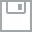
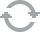
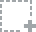
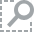
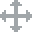
...
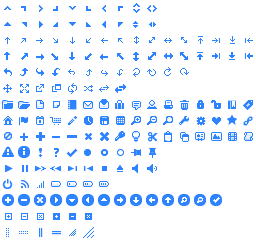
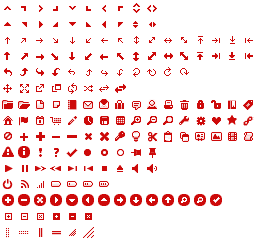
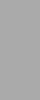
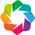
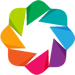

In [57]:
import numpy as np
import pandas as pd

from sklearn.cross_validation import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.datasets import make_moons, make_circles, make_classification
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.lda import LDA
from sklearn.qda import QDA

from bokeh.plotting import figure,gridplot,show,output_notebook
from bokeh.models import Range1d
output_notebook()

%matplotlib inline

##Investigating Decision Boundaries
Visually understanding how some classifiers make decisions; adapted from an sklearn page, which will be shared after lab. 

The goal here is to investigate the code and describe in layman's terms what is happening in the specific chunk. If there is a variable being referenced outside of your chunk, or your in a loop, refer to what's happening in one iteration of the loop.

In [58]:

# ====================================================================== #
# Part 1

names = ["Nearest Neighbors", "Linear SVM", "RBF SVM", "Decision Tree",
         "Random Forest", "AdaBoost", "Naive Bayes", "LDA", "QDA"]
classifiers = [
    KNeighborsClassifier(3),
    SVC(kernel="linear", C=0.025),
    SVC(gamma=2, C=1),
    DecisionTreeClassifier(max_depth=5),
    RandomForestClassifier(max_depth=5, n_estimators=10, max_features=1),
    AdaBoostClassifier(),
    GaussianNB(),
    LDA(),
    QDA()]

# 2 features, 2 classes, these are normally distributed (std =1)
# These points are clustered - make classification generates linearly separable
X, y = make_classification(n_features=2, n_redundant=0, n_informative=2,
                           random_state=1, n_clusters_per_class=1)
rng = np.random.RandomState(2) #generate uniformly distributed points
X += 2 * rng.uniform(size=X.shape) #adds noise, or random numbers
linearly_separable = (X, y) 

datasets = [make_moons(noise=0.3, random_state=0),
            make_circles(noise=0.2, factor=0.5, random_state=1),
            linearly_separable
            ] # generated separable data sets in the same shape



In [59]:
X, y = make_classification(n_features=2, n_redundant=0, n_informative=2,
                           random_state=1, n_clusters_per_class=1)
rng = np.random.RandomState(2) #generate uniformly distributed points
X += 2 * rng.uniform(size=X.shape) #adds noise, or random numbers
linearly_separable = (X, y)

In [60]:
X

array([[ 1.77018953,  0.83370131],
       [ 0.95226232,  2.31722952],
       [ 1.72648875,  1.55821601],
       [ 0.34470695,  3.21632935],
       [-0.13810849,  2.03963088],
       [ 0.61542489,  2.49574247],
       [ 1.2991231 ,  2.1315897 ],
       [-0.42720793,  2.73523908],
       [ 0.95201805,  2.34618385],
       [ 2.84269076,  1.43058836],
       [ 2.08207784,  1.12393578],
       [ 0.24171906,  1.79170173],
       [ 1.03918916,  2.13459841],
       [ 1.26818624,  0.69591846],
       [ 0.08139118,  3.20774178],
       [ 1.87233245,  1.39129818],
       [ 2.23802442,  1.98774095],
       [ 2.06675264,  2.06694202],
       [ 0.44708851,  2.36176971],
       [ 1.30101841,  2.4167165 ],
       [ 0.30021539,  1.47636376],
       [ 2.81854758,  1.73881541],
       [-0.47385483,  1.97875278],
       [-1.46534626,  1.21805551],
       [ 1.85895478,  2.36947613],
       [-0.10236831,  0.70298149],
       [ 1.77254759,  2.77175728],
       [ 0.18853426,  1.33848656],
       [ 1.17166732,

Describe here what is going on:

In [61]:
full_grid = []
for data in datasets:
# ====================================================================== #
# Part 2

    h = .02  # step size in the meshgrid
    
    X, y = data
    X = StandardScaler().fit_transform(X)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.4)

    x_min, x_max = X[:, 0].min() - .5, X[:, 0].max() + .5 # define boundaries for the graph
    y_min, y_max = X[:, 1].min() - .5, X[:, 1].max() + .5
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                         np.arange(y_min, y_max, h))

    raw = figure(title="Raw Data", tools='',
                x_range=(xx.min(), xx.max()), 
                y_range=(yy.min(), yy.max()),
                width=180, plot_height=220,
                min_border=1,
                title_text_font_size='10pt' ) # figure for the raw data plot

    color_dict = {0:'blue',1:'red'} # defining map

    train_colors = [color_dict[label] for label in y_train] # recreating list that creates blue/red based on 0, 1
    raw.circle(X_train[:, 0], X_train[:, 1], 
               color=train_colors) # putting list into a circle plot

    test_colors = [color_dict[label] for label in y_test]
    raw.circle(X_test[:, 0], X_test[:, 1], 
               color=test_colors, alpha=0.6) # 


    
# ====================================================================== #
# Part 3

    row=[raw] # create list
    for name, clf in zip(names, classifiers):
        clf.fit(X_train, y_train) # zip function match each name to it's classifier
        score = clf.score(X_test, y_test) # look on list of all classifiers, zip (two lists 1,2,3 and a,b,c) - iterate in the same look on things such as 1a, 2b, 3c - zip bundles it

        if hasattr(clf, "decision_function"):
            Z = clf.decision_function(np.c_[xx.ravel(), yy.ravel()]) # if model has attribute decision_function, then do it
        else:
            Z = clf.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:, 1] # otherwise do the predict function

            # xx and yy = mesh grid
        
        Z = Z.reshape(xx.shape) # Z is a vector of probabilities
        Z = Z/Z.max() # this is a hack, it rescaled to make colors work in the charts
        control_row = np.ones(Z.shape[1])+0.001
        #NOTE: control row adds a max value outside of the grid to correct colors. 
        # Don't worry about explaining control_row
        Z = np.vstack((Z,control_row))


        p1 = figure(title=name, tools='',
                    x_range=(xx.min(), xx.max()), 
                    y_range=(yy.min(), yy.max()),
                    width=180, plot_height=220,
                    min_border=1,
                    title_text_font_size='10pt') # create another figure, overlay image of decision function as below


        p1.image(image=[Z], x=[xx.min()], y=[yy.min()], dw=[xx.max()-xx.min()], dh=[yy.max()-yy.min()],
                palette='RdYlBu11')

        p1.circle(X_train[:, 0], X_train[:, 1], 
                  color=train_colors,
                  line_color='black',
                  size=3)
        p1.circle(X_test[:, 0], X_test[:, 1], 
                  color=test_colors, 
                  alpha=0.6,
                  line_color='black',
                  size=3)

        p1.text(x=[xx.max()-1.5],y=[yy.min()],
                text=[str(score)],
                text_font_size='15pt',
                text_font_style='bold')
        
        row.append(p1) # append figure to list of figures, creating a list with all of the plots
    
    grid = np.array(row).reshape(2,len(row)/2)
    full_grid.append(grid)
    
final_grid = np.vstack(full_grid)
show(gridplot(final_grid.tolist()))

###Random Forests
Random forests are a type of ensemble method (which we hinted at above) that build out groups of decision trees

In [62]:
from sklearn.cross_validation import ShuffleSplit

titanic = pd.read_csv('../data/titanic-train.csv')
titanic.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 891 entries, 0 to 890
Data columns (total 12 columns):
PassengerId    891 non-null int64
Survived       891 non-null int64
Pclass         891 non-null int64
Name           891 non-null object
Sex            891 non-null object
Age            714 non-null float64
SibSp          891 non-null int64
Parch          891 non-null int64
Ticket         891 non-null object
Fare           891 non-null float64
Cabin          204 non-null object
Embarked       889 non-null object
dtypes: float64(2), int64(5), object(5)
memory usage: 90.5+ KB


Let's preprocess our data. Age needs to be imputed or dropped, Sex needs to be converted to a boolean data type, and to use our categorical feature `Embarked` we must use `pd.get_dummies` on it

In [63]:
average_age = titanic['Age'].mean()
titanic['Age'] = titanic['Age'].fillna(average_age)

In [64]:
titanic['is_female'] = titanic.Sex=='female'
titanic.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,is_female
0,1,0,3,"Braund, Mr. Owen Harris",male,22,1,0,A/5 21171,7.2500,NaN,S,False
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38,1,0,PC 17599,71.2833,C85,C,True
2,3,1,3,"Heikkinen, Miss. Laina",female,26,0,0,STON/O2. 3101282,7.9250,NaN,S,True
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35,1,0,113803,53.1000,C123,S,True
4,5,0,3,"Allen, Mr. William Henry",male,35,0,0,373450,8.0500,NaN,S,False


In [65]:
embarked_categories = pd.get_dummies(titanic.Embarked,prefix='Embarked')
titanic[embarked_categories.columns] = embarked_categories
titanic.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,is_female,Embarked_C,Embarked_Q,Embarked_S
0,1,0,3,"Braund, Mr. Owen Harris",male,22,1,0,A/5 21171,7.2500,NaN,S,False,0,0,1
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38,1,0,PC 17599,71.2833,C85,C,True,1,0,0
2,3,1,3,"Heikkinen, Miss. Laina",female,26,0,0,STON/O2. 3101282,7.9250,NaN,S,True,0,0,1
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35,1,0,113803,53.1000,C123,S,True,0,0,1
4,5,0,3,"Allen, Mr. William Henry",male,35,0,0,373450,8.0500,NaN,S,False,0,0,1


In [66]:
feature_columns = 'Age,Parch,Pclass,Fare,Embarked_C,Embarked_Q,Embarked_S'.split(',')
for train,test in ShuffleSplit(len(titanic),test_size=.2,n_iter = 1):

    X_train = titanic[feature_columns].iloc[train]
    y_train = titanic['Survived'].iloc[train]
    X_test = titanic[feature_columns].iloc[test]
    y_test = titanic['Survived'].iloc[test]
    
feature_columns

['Age', 'Parch', 'Pclass', 'Fare', 'Embarked_C', 'Embarked_Q', 'Embarked_S']

In [67]:
# We already imported the RandomForest above, but here it is for reference:
# from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier

rfc = RandomForestClassifier(max_depth=5, n_estimators=100, max_features=3)
rfc.fit(X_train,y_train)
rfc.score(X_test,y_test)

0.74860335195530725

This is an interesting general score but let's be more thorough and get a cross evaluation score, and see how it grows with the size of our forest (`n_estimators`).

In [68]:
from sklearn.cross_validation import cross_val_score

features = titanic[feature_columns]
target = titanic['Survived']

forest_size = range(2,100,2)
y = []
for i in forest_size:
    rfc = RandomForestClassifier(max_depth=5, n_estimators=i, max_features=4) # new random forest classifier
    accuracy = cross_val_score(rfc, features, target, cv=5).mean() # list of 5 numbers, throw .mean to get avg score
    
    y.append(accuracy)
p1 = figure(title='Random Forest Classifier performance',tools='') # simple plot
p1.line(x=forest_size,y=y, color='green')


show(p1)

# graph below shows number of trees vs. performance of the models

# good starting place for no. of features - not neccesarily 

How does the classifier change as we allow for more complexity?  (i.e. deeper trees)

In [69]:
tree_depth = range(1,50)
y = []
for i in tree_depth:
    rfc = RandomForestClassifier(max_depth=i, n_estimators=20, max_features=4)
    accuracy = cross_val_score(rfc, features, target, cv=5).mean()
    
    y.append(accuracy)
p1 = figure(title='Random Forest Classifier performance',x_axis_label='Max Tree Depth',tools='')
p1.line(x=tree_depth,y=y, color='green')


show(p1)

# graph below visualizes overfitting and knowing where to stop

## Exercise: Random Forest Regression

In [70]:
from sklearn.metrics import precision_recall_fscore_support
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble.partial_dependence import plot_partial_dependence
from sklearn.cross_validation import train_test_split
import pandas as pd
from sklearn.preprocessing import LabelEncoder

%matplotlib inline
import matplotlib.pyplot as plt

In [71]:
df = pd.read_csv('../data/cell_phone_churn.csv')
df.head()

,state,account_length,area_code,intl_plan,vmail_plan,vmail_message,day_mins,day_calls,day_charge,eve_mins,eve_calls,eve_charge,night_mins,night_calls,night_charge,intl_mins,intl_calls,intl_charge,custserv_calls,churn
0,KS,128,415,no,yes,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False.
1,OH,107,415,no,yes,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False.
2,NJ,137,415,no,no,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False.
3,OH,84,408,yes,no,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False.
4,OK,75,415,yes,no,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False.


In [72]:
# Some Prepreocessing
state_encoder = LabelEncoder()  
df.state = state_encoder.fit_transform(df.state)


binary_columns = ['intl_plan', 'vmail_plan', 'churn']  
for col in binary_columns:  
    df[col] = df[col].map({
            'no': 0
        ,   'False.': 0
        ,   'yes': 1
        ,   'True.': 1
    })

Steps:
----
1. Explore the data and plot histograms of several columns. Hypothesize whether a relationship exists. 
2. Evaluate and compare the `precision and recall` of 
    - `GradientBoostingClassifier` 
    - `RandomForestClassifier`
    - `DecisionTreeClassifier`
    - `Logistic Regression`
        - hint!: use the `precision_recall_fscore_support` built into sklearn 
3. Tune the models using a grid-search of several parameters 
    - Determine which score (accuracy? F1 score? ...) you will use for your grid search. Explain why to your partner
    - Hint: for `DecisionTreeClassifier` and `RandomForestClassifier`, 
        look at the docs to see which hyperparameters need tuning.  
4. Plot feature importance for one of your models (using the `.feature_importances_` property)
    - Hint: load `feature_importances_` into a `pandas.Series` and use `.plot(kind='barh')` 
5. Plot a learning curve for the same model


In [74]:
#Your Code here

df.columns


Index([u'state', u'account_length', u'area_code', u'intl_plan', u'vmail_plan',
       u'vmail_message', u'day_mins', u'day_calls', u'day_charge', u'eve_mins',
       u'eve_calls', u'eve_charge', u'night_mins', u'night_calls',
       u'night_charge', u'intl_mins', u'intl_calls', u'intl_charge',
       u'custserv_calls', u'churn'],
      dtype='object')

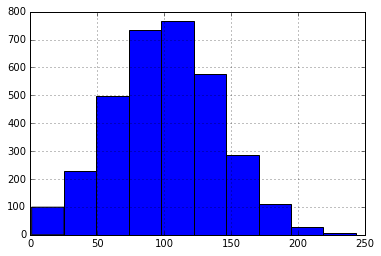

In [77]:
df['account_length'].hist()

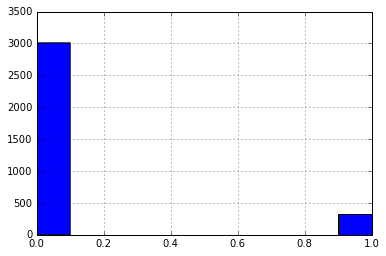

In [78]:
df['intl_plan'].hist()

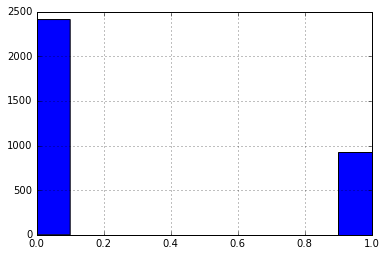

In [79]:
df['vmail_plan'].hist()

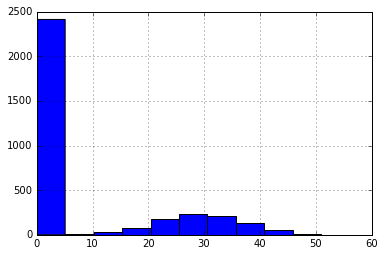

In [80]:
df['vmail_message'].hist()

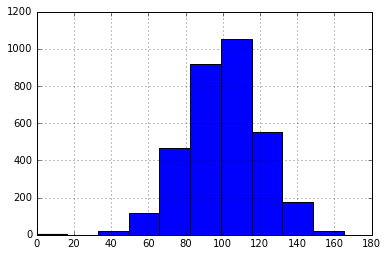

In [82]:
df['day_calls'].hist()
# < 80 day calls

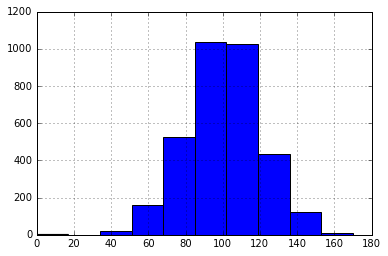

In [84]:
df['eve_calls'].hist()
# < 90 eve calls

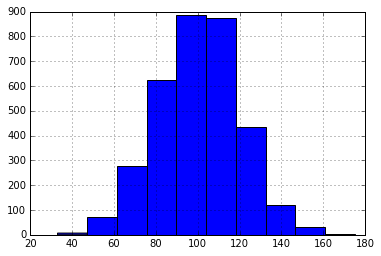

In [85]:
df['night_calls'].hist()
# < 80 night calls

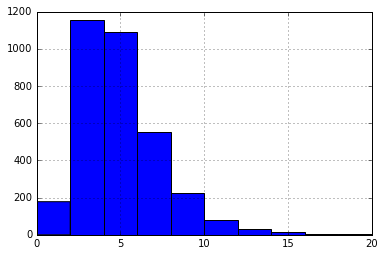

In [86]:
df['intl_calls'].hist()

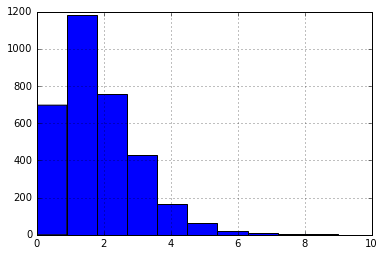

In [87]:
df['custserv_calls'].hist()
# >2 customer service calls

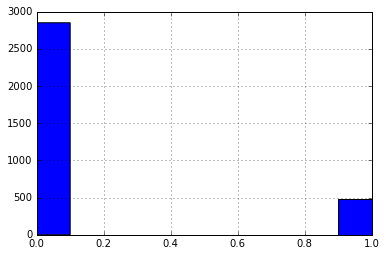

In [88]:
df['churn'].hist()

In [92]:
df.columns

Index([u'state', u'account_length', u'area_code', u'intl_plan', u'vmail_plan',
       u'vmail_message', u'day_mins', u'day_calls', u'day_charge', u'eve_mins',
       u'eve_calls', u'eve_charge', u'night_mins', u'night_calls',
       u'night_charge', u'intl_mins', u'intl_calls', u'intl_charge',
       u'custserv_calls', u'churn', u'high_custserv_calls', u'low_night_calls',
       u'low_eve_calls', u'low_day_calls'],
      dtype='object')

In [90]:
'custserv_calls'
# > 2 customer service calls
'night_calls'
# < 80 night calls
'eve_calls'
# < 90 eve calls
'day_calls'
# < 80 day calls

# Put these in binary format

df['high_custserv_calls'] = df.custserv_calls > 2
df['low_night_calls'] = df.night_calls < 80
df['low_eve_calls'] = df.eve_calls < 90
df['low_day_calls'] = df.day_calls < 80

df.head()



,state,account_length,area_code,intl_plan,vmail_plan,vmail_message,day_mins,day_calls,day_charge,eve_mins,...,night_charge,intl_mins,intl_calls,intl_charge,custserv_calls,churn,high_custserv_calls,low_night_calls,low_eve_calls,low_day_calls
0,16,128,415,0,1,25,265.1,110,45.07,197.4,...,11.01,10.0,3,2.70,1,0,False,False,False,False
1,35,107,415,0,1,26,161.6,123,27.47,195.5,...,11.45,13.7,3,3.70,1,0,False,False,False,False
2,31,137,415,0,0,0,243.4,114,41.38,121.2,...,7.32,12.2,5,3.29,0,0,False,False,False,False
3,35,84,408,1,0,0,299.4,71,50.90,61.9,...,8.86,6.6,7,1.78,2,0,False,False,True,True
4,36,75,415,1,0,0,166.7,113,28.34,148.3,...,8.41,10.1,3,2.73,3,0,True,False,False,False
